<a href="https://colab.research.google.com/github/kridtapon/CMO-Trix-Momentum/blob/main/CMO_Trix_Momentum.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
pip install vectorbt

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 527.5/527.5 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.5/3.5 MB 37.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 43.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 295.0/295.0 kB 23.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.4/119.4 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.6/34.6 MB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 53.1 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 1.26.4
    Uninstalling numpy-1.26.4:
      Successfully uninstalled numpy-1.26.4
  Attempting uninstall: llvmlite
    Found existing installation: llvmlite 0.43.0
    Uninstalling llvmlite-0.43.0:
      Successfully uninstalled llvmlite-0.43.0
  Attempting uninstall: numba
    Found existing installation: numba 0.60.0
    Uninstalling numba-0.60.0:
      Successfully unins

In [ ]:
import numpy as np
import pandas as pd
import yfinance as yf
import vectorbt as vbt

# Chande Momentum Oscillator (CMO)
def chande_momentum_oscillator(df, period=14):
    df['CMO'] = ((df['Close'] - df['Close'].shift(period)).rolling(window=period).sum()) / \
                ((df['Close'] - df['Close'].shift(1)).abs().rolling(window=period).sum()) * 100
    return df['CMO']

# Trix Indicator
def trix(df, period=14):
    df['Trix'] = df['Close'].ewm(span=period, min_periods=period).mean()
    df['Trix_Signal'] = df['Trix'].ewm(span=period, min_periods=period).mean()
    return df['Trix'], df['Trix_Signal']

# Define the stock symbol and time period
symbol = 'TRGP' # FOX TRGP
start_date = '2019-01-01'
end_date = '2025-01-01'

# Download the data
df = yf.download(symbol, start=start_date, end=end_date)
df.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
df.ffill(inplace=True)

# Function to calculate portfolio performance
def calculate_performance(cmo_period, trix_period):
    # Calculate CMO and Trix for each period
    df['CMO'] = chande_momentum_oscillator(df, cmo_period)
    df['Trix'], df['Trix_Signal'] = trix(df, trix_period)

    # Define entry and exit signals based on CMO and Trix
    df['Entry'] = (
        (df['CMO'] > 0) &  # CMO crosses above 0
        (df['Trix'] > df['Trix_Signal'])   # Trix crosses above Trix Signal line
    )

    df['Exit'] = (
        (df['CMO'] < 0) &  # CMO crosses below 0
        (df['Trix'] < df['Trix_Signal'])   # Trix crosses below Trix Signal line
    )

    # Filter data for test only
    df_filtered = df[(df.index.year >= 2020) & (df.index.year <= 2025)]

    # Convert signals to boolean arrays
    entries = df_filtered['Entry'].to_numpy()
    exits = df_filtered['Exit'].to_numpy()

    # Backtest using vectorbt
    portfolio = vbt.Portfolio.from_signals(
        close=df_filtered['Close'],
        entries=entries,
        exits=exits,
        init_cash=100_000,
        fees=0.001
    )

    # Return total return as performance metric
    return portfolio.total_return()

# Define the range of periods for optimization
cmo_period_range = range(1, 21)  # Example range for CMO period
trix_period_range = range(1, 21)  # Example range for Trix period

best_total_return = -np.inf
best_cmo_period = None
best_trix_period = None

# Loop over all combinations of periods and find the best total return
for cmo_period in cmo_period_range:
    for trix_period in trix_period_range:
        total_return = calculate_performance(cmo_period, trix_period)
        if total_return > best_total_return:
            best_total_return = total_return
            best_cmo_period = cmo_period
            best_trix_period = trix_period

print(f"Best CMO Period: {best_cmo_period}")
print(f"Best Trix Period: {best_trix_period}")
print(f"Best Total Return: {best_total_return}")

# Now, you can calculate the portfolio using the best parameters
df['CMO'] = chande_momentum_oscillator(df, best_cmo_period)
df['Trix'], df['Trix_Signal'] = trix(df, best_trix_period)

df['Entry'] = (
    (df['CMO'] > 0) &
    (df['Trix'] > df['Trix_Signal'])
)

df['Exit'] = (
    (df['CMO'] < 0) &
    (df['Trix'] < df['Trix_Signal'])
)

df_filtered = df[(df.index.year >= 2020) & (df.index.year <= 2025)]

entries = df_filtered['Entry'].to_numpy()
exits = df_filtered['Exit'].to_numpy()

portfolio = vbt.Portfolio.from_signals(
    close=df_filtered['Close'],
    entries=entries,
    exits=exits,
    init_cash=100_000,
    fees=0.001
)

# Display performance metrics and plot
print(portfolio.stats())
portfolio.plot().show()


[*********************100%***********************]  1 of 1 completed


Best CMO Period: 12
Best Trix Period: 6
Best Total Return: 15.774485142344563
Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                          1677448.514234
Total Return [%]                      1577.448514
Benchmark Return [%]                   396.466148
Max Gross Exposure [%]                      100.0
Total Fees Paid                      25245.583047
Max Drawdown [%]                        40.536382
Max Drawdown Duration                       470.0
Total Trades                                   18
Total Closed Trades                            18
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            55.555556
Best Trade [%]                         130.816409
Worst Trade [%]                        -17.074555
Avg Winning Trade [%] 

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



[*********************100%***********************]  1 of 1 completed


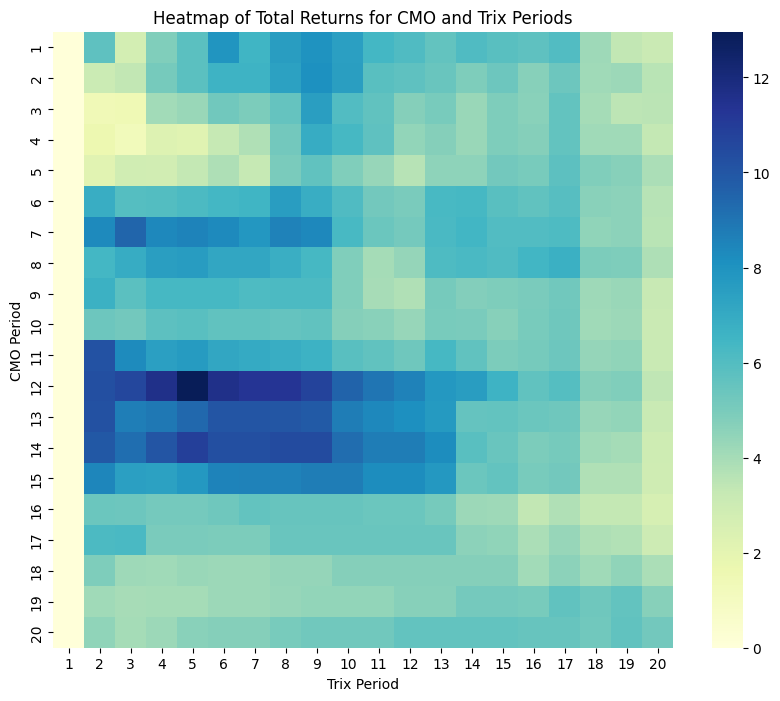

Best CMO Period: 12
Best Trix Period: 5
Best Total Return: 12.962181369317998
Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                          1396218.136932
Total Return [%]                      1296.218137
Benchmark Return [%]                   339.546903
Max Gross Exposure [%]                      100.0
Total Fees Paid                      24773.210541
Max Drawdown [%]                        40.536397
Max Drawdown Duration                       483.0
Total Trades                                   19
Total Closed Trades                            19
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            52.631579
Best Trade [%]                         128.926743
Worst Trade [%]                        -17.074559
Avg Winning Trade [%] 

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



In [4]:
import numpy as np
import pandas as pd
import yfinance as yf
import vectorbt as vbt
import seaborn as sns
import matplotlib.pyplot as plt

# Chande Momentum Oscillator (CMO)
def chande_momentum_oscillator(df, period=14):
    df['CMO'] = ((df['Close'] - df['Close'].shift(period)).rolling(window=period).sum()) / \
                ((df['Close'] - df['Close'].shift(1)).abs().rolling(window=period).sum()) * 100
    return df['CMO']

# Trix Indicator
def trix(df, period=14):
    df['Trix'] = df['Close'].ewm(span=period, min_periods=period).mean()
    df['Trix_Signal'] = df['Trix'].ewm(span=period, min_periods=period).mean()
    return df['Trix'], df['Trix_Signal']

# Define the stock symbol and time period
symbol = 'TRGP'  # FOX TRGP
start_date = '2019-01-01'
end_date = '2025-01-01'

# Download the data
df = yf.download(symbol, start=start_date, end=end_date)
df.columns = ['Adj Close','Close', 'High', 'Low', 'Open', 'Volume']
df.ffill(inplace=True)

# Function to calculate portfolio performance
def calculate_performance(cmo_period, trix_period):
    # Calculate CMO and Trix for each period
    df['CMO'] = chande_momentum_oscillator(df, cmo_period)
    df['Trix'], df['Trix_Signal'] = trix(df, trix_period)

    # Define entry and exit signals based on CMO and Trix
    df['Entry'] = (
        (df['CMO'] > 0) &  # CMO crosses above 0
        (df['Trix'] > df['Trix_Signal'])   # Trix crosses above Trix Signal line
    )

    df['Exit'] = (
        (df['CMO'] < 0) &  # CMO crosses below 0
        (df['Trix'] < df['Trix_Signal'])   # Trix crosses below Trix Signal line
    )

    # Filter data for test only
    df_filtered = df[(df.index.year >= 2020) & (df.index.year <= 2025)]

    # Convert signals to boolean arrays
    entries = df_filtered['Entry'].to_numpy()
    exits = df_filtered['Exit'].to_numpy()

    # Backtest using vectorbt
    portfolio = vbt.Portfolio.from_signals(
        close=df_filtered['Close'],
        entries=entries,
        exits=exits,
        init_cash=100_000,
        fees=0.001
    )

    # Return total return as performance metric
    return portfolio.total_return()

# Define the range of periods for optimization
cmo_period_range = range(1, 21)  # Example range for CMO period
trix_period_range = range(1, 21)  # Example range for Trix period

# Create an empty matrix to store the total returns for each combination of periods
total_returns_matrix = np.zeros((len(cmo_period_range), len(trix_period_range)))

# Loop over all combinations of periods and store the total returns
for i, cmo_period in enumerate(cmo_period_range):
    for j, trix_period in enumerate(trix_period_range):
        total_returns_matrix[i, j] = calculate_performance(cmo_period, trix_period)

# Plot the heatmap of total returns
plt.figure(figsize=(10, 8))
sns.heatmap(total_returns_matrix, annot=False, cmap="YlGnBu", xticklabels=trix_period_range, yticklabels=cmo_period_range)
plt.title('Heatmap of Total Returns for CMO and Trix Periods')
plt.xlabel('Trix Period')
plt.ylabel('CMO Period')
plt.show()

# Find the best parameters based on the highest total return
best_cmo_period_idx, best_trix_period_idx = np.unravel_index(np.argmax(total_returns_matrix), total_returns_matrix.shape)
best_cmo_period = cmo_period_range[best_cmo_period_idx]
best_trix_period = trix_period_range[best_trix_period_idx]

print(f"Best CMO Period: {best_cmo_period}")
print(f"Best Trix Period: {best_trix_period}")
print(f"Best Total Return: {total_returns_matrix[best_cmo_period_idx, best_trix_period_idx]}")

# Now, calculate the portfolio using the best parameters
df['CMO'] = chande_momentum_oscillator(df, best_cmo_period)
df['Trix'], df['Trix_Signal'] = trix(df, best_trix_period)

df['Entry'] = (
    (df['CMO'] > 0) &
    (df['Trix'] > df['Trix_Signal'])
)

df['Exit'] = (
    (df['CMO'] < 0) &
    (df['Trix'] < df['Trix_Signal'])
)

df_filtered = df[(df.index.year >= 2020) & (df.index.year <= 2025)]

entries = df_filtered['Entry'].to_numpy()
exits = df_filtered['Exit'].to_numpy()

portfolio = vbt.Portfolio.from_signals(
    close=df_filtered['Close'],
    entries=entries,
    exits=exits,
    init_cash=100_000,
    fees=0.001
)

# Display performance metrics and plot
print(portfolio.stats())
portfolio.plot().show()


In [1]:
pip install mplfinance

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.0/75.0 kB 4.3 MB/s eta 0:00:00


[*********************100%***********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/mplfinance/_arg_validators.py:84: UserWarning:




            POSSIBLE TO SEE DETAILS (Candles, Ohlc-Bars, Etc.)
   For more information see:
   - https://github.com/matplotlib/mplfinance/wiki/Plotting-Too-Much-Data
   
   TO SILENCE THIS WARNING, set `type='line'` in `mpf.plot()`
   OR set kwarg `warn_too_much_data=N` where N is an integer 
   LARGER than the number of data points you want to plot.




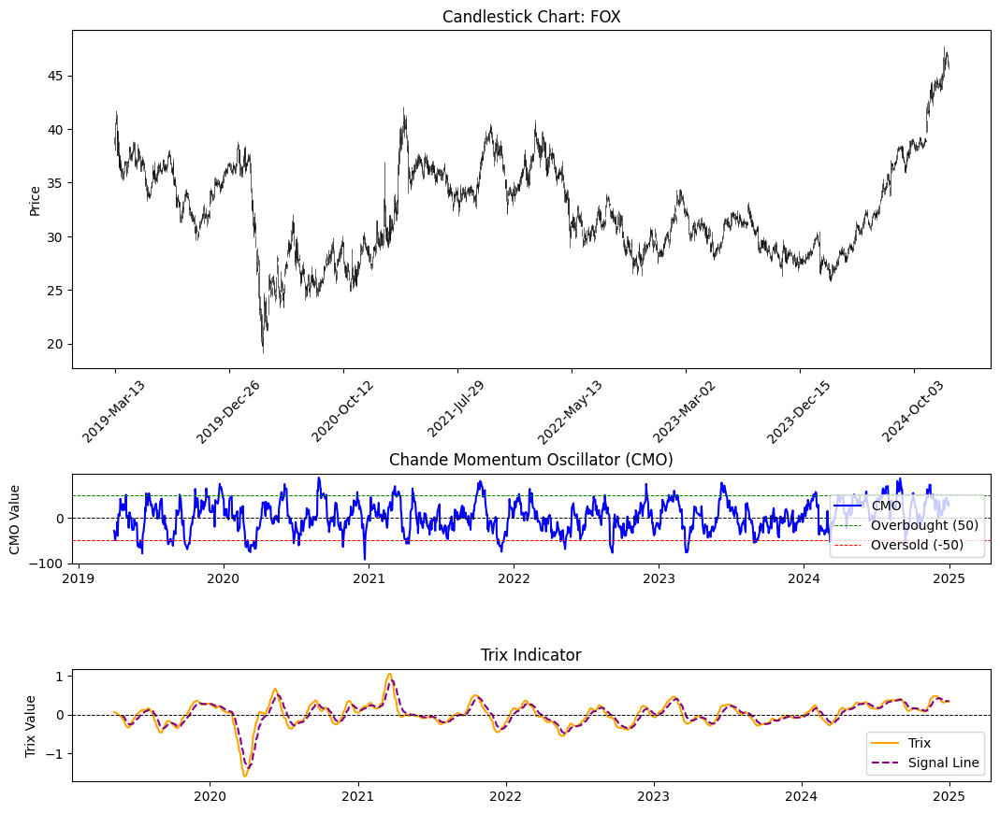

In [5]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt
import mplfinance as mpf

# Chande Momentum Oscillator (CMO)
def chande_momentum_oscillator(df, period=14):
    up = df['Close'].diff()
    gain = up.where(up > 0, 0).rolling(window=period).sum()
    loss = -up.where(up < 0, 0).rolling(window=period).sum()
    cmo = (gain - loss) / (gain + loss) * 100
    return cmo

# Trix Indicator
def trix(df, period=14):
    ema1 = df['Close'].ewm(span=period, min_periods=period).mean()
    ema2 = ema1.ewm(span=period, min_periods=period).mean()
    ema3 = ema2.ewm(span=period, min_periods=period).mean()
    trix = (ema3 - ema3.shift(1)) / ema3.shift(1) * 100
    signal = trix.ewm(span=period, min_periods=period).mean()
    return trix, signal

# Define the stock symbol and time period
symbol = 'FOX'  # Change this to your preferred stock symbol
start_date = '2019-01-01'
end_date = '2025-01-01'

# Download the data
df = yf.download(symbol, start=start_date, end=end_date)
df.columns = ['Adj Close','Close', 'High', 'Low', 'Open', 'Volume']
df.ffill(inplace=True)
df['CMO'] = chande_momentum_oscillator(df, period=14)
df['Trix'], df['Trix_Signal'] = trix(df, period=14)

# Set up subplots
fig, (ax1, ax2, ax3) = plt.subplots(
    3,
    1,
    figsize=(12, 10),
    gridspec_kw={'height_ratios': [3, 0.8, 1]}  # Increased distance by reducing CMO height slightly
)
fig.tight_layout(pad=6)  # Increased padding between plots

# Plot candlestick chart
mpf.plot(df, type='candle', ax=ax1, volume=False, show_nontrading=False)
ax1.set_title(f'Candlestick Chart: {symbol}')
ax1.set_ylabel('Price')

# Plot CMO
ax2.plot(df.index, df['CMO'], label='CMO', color='blue')
ax2.axhline(50, color='green', linestyle='--', linewidth=0.7, label='Overbought (50)')
ax2.axhline(-50, color='red', linestyle='--', linewidth=0.7, label='Oversold (-50)')
ax2.axhline(0, color='black', linestyle='--', linewidth=0.7)
ax2.set_title('Chande Momentum Oscillator (CMO)')
ax2.set_ylabel('CMO Value')
ax2.legend()

# Plot Trix and Signal Line
ax3.plot(df.index, df['Trix'], label='Trix', color='orange')
ax3.plot(df.index, df['Trix_Signal'], label='Signal Line', color='purple', linestyle='--')
ax3.axhline(0, color='black', linestyle='--', linewidth=0.7)
ax3.set_title('Trix Indicator')
ax3.set_ylabel('Trix Value')
ax3.legend()

# Show the plot
plt.show()


In [ ]:
import numpy as np
import pandas as pd
import yfinance as yf
import vectorbt as vbt

# Chande Momentum Oscillator (CMO)
def chande_momentum_oscillator(df, period=14):
    df['CMO'] = ((df['Close'] - df['Close'].shift(period)).rolling(window=period).sum()) / \
                ((df['Close'] - df['Close'].shift(1)).abs().rolling(window=period).sum()) * 100
    return df['CMO']

# Trix Indicator
def trix(df, period=14):
    df['Trix'] = df['Close'].ewm(span=period, min_periods=period).mean()
    df['Trix_Signal'] = df['Trix'].ewm(span=period, min_periods=period).mean()
    return df['Trix'], df['Trix_Signal']

# Define the stock symbol and time period
symbol = 'FOX' # FOX TRGP
start_date = '2019-01-01'
end_date = '2025-01-01'

# Download the data
df = yf.download(symbol, start=start_date, end=end_date)
df.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
df.ffill(inplace=True)

# Calculate CMO and Trix
df['CMO'] = chande_momentum_oscillator(df, 14)
df['Trix'], df['Trix_Signal'] = trix(df, 14)

# Define entry and exit signals based on CMO and Trix
df['Entry'] = (
    (df['CMO'] > 0) &  # CMO crosses above 0
    (df['Trix'] > df['Trix_Signal'])   # Trix crosses above Trix Signal line
)

df['Exit'] = (
    (df['CMO'] < 0) &  # CMO crosses below 0
    (df['Trix'] < df['Trix_Signal'])   # Trix crosses below Trix Signal line
)

# Filter data for test only
df = df[(df.index.year >= 2020) & (df.index.year <= 2025)]

# Convert signals to boolean arrays
entries = df['Entry'].to_numpy()
exits = df['Exit'].to_numpy()

# Backtest using vectorbt
portfolio = vbt.Portfolio.from_signals(
    close=df['Close'],
    entries=entries,
    exits=exits,
    init_cash=100_000,
    fees=0.001
)

# Display performance metrics
print(portfolio.stats())

# Plot equity curve
portfolio.plot().show()


[*********************100%***********************]  1 of 1 completed
/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           190334.723762
Total Return [%]                        90.334724
Benchmark Return [%]                    35.322367
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4066.888102
Max Drawdown [%]                        26.281784
Max Drawdown Duration                       368.0
Total Trades                                   18
Total Closed Trades                            17
Total Open Trades                               1
Open Trade PnL                       74738.567989
Win Rate [%]                            47.058824
Best Trade [%]                          21.386371
Worst Trade [%]                         -4.908968
Avg Winning Trade [%]                    5.199516
Avg Losing Trade [%]                    -2.668664


In [ ]:
import numpy as np
import pandas as pd
import yfinance as yf
import vectorbt as vbt

# Chande Momentum Oscillator (CMO)
def chande_momentum_oscillator(df, period=14):
    df['CMO'] = ((df['Close'] - df['Close'].shift(period)).rolling(window=period).sum()) / \
                ((df['Close'] - df['Close'].shift(1)).abs().rolling(window=period).sum()) * 100
    return df['CMO']

# Trix Indicator
def trix(df, period=14):
    df['Trix'] = df['Close'].ewm(span=period, min_periods=period).mean()
    df['Trix_Signal'] = df['Trix'].ewm(span=period, min_periods=period).mean()
    return df['Trix'], df['Trix_Signal']

# List of stock symbols
symbols = ['ANET', 'APO', 'AVGO', 'AXON', 'CEG', 'DECK', 'FICO', 'FOX', 'FOXA', 'GDDY', 'HWM', 'KKR', 'META',
           'NFLX', 'NRG', 'NVDA', 'PLTR', 'RCL', 'SYF', 'TPL', 'TPR', 'TRGP', 'UAL', 'VST', 'WMT']

# Time period
start_date = '2019-01-01'
end_date = '2025-01-01'

# Loop through each stock symbol
for symbol in symbols:
    print(f"Processing {symbol}...")

    # Download the data
    df = yf.download(symbol, start=start_date, end=end_date)
    df.columns = ['Close', 'High', 'Low', 'Open', 'Volume']
    df.ffill(inplace=True)

    # Calculate CMO and Trix
    df['CMO'] = chande_momentum_oscillator(df, 14)
    df['Trix'], df['Trix_Signal'] = trix(df, 14)

    # Define entry and exit signals based on CMO and Trix
    df['Entry'] = (
        (df['CMO'] > 0) &  # CMO crosses above 0
        (df['Trix'] > df['Trix_Signal'])   # Trix crosses above Trix Signal line
    )

    df['Exit'] = (
        (df['CMO'] < 0) &  # CMO crosses below 0
        (df['Trix'] < df['Trix_Signal'])   # Trix crosses below Trix Signal line
    )

    # Filter data for test only
    df = df[(df.index.year >= 2020) & (df.index.year <= 2025)]

    # Convert signals to boolean arrays
    entries = df['Entry'].to_numpy()
    exits = df['Exit'].to_numpy()

    # Backtest using vectorbt
    portfolio = vbt.Portfolio.from_signals(
        close=df['Close'],
        entries=entries,
        exits=exits,
        init_cash=100_000,
        fees=0.001
    )

    # Buy and hold strategy
    buy_and_hold = vbt.Portfolio.from_orders(
        close=df['Close'],
        size=1,
        init_cash=100_000,
        fees=0.001
    )

    # Print performance metrics for each stock
    print(f"Performance for {symbol}:")
    print("Backtest strategy performance:")
    print(portfolio.stats())
    print("Buy and hold performance:")
    print(buy_and_hold.stats())
    print("-" * 50)

    # Plot equity curve for the strategy and buy and hold
    portfolio.plot().show()
    buy_and_hold.plot().show()


[*********************100%***********************]  1 of 1 completed

Processing ANET...
Performance for ANET:
Backtest strategy performance:
Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           330264.669416
Total Return [%]                       230.264669
Benchmark Return [%]                   763.853053
Max Gross Exposure [%]                      100.0
Total Fees Paid                       6384.818734
Max Drawdown [%]                        34.433967
Max Drawdown Duration                       305.0
Total Trades                                   17
Total Closed Trades                            16
Total Open Trades                               1
Open Trade PnL                       10736.416419
Win Rate [%]                                68.75
Best Trade [%]                            38.1656
Worst Trade [%]                        -14.133211
Avg Winning Trade [%]       


/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



[*********************100%***********************]  1 of 1 completed

Processing APO...
Performance for APO:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           269142.083522
Total Return [%]                       169.142084
Benchmark Return [%]                   302.647058
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4628.655031
Max Drawdown [%]                        37.119144
Max Drawdown Duration                       772.0
Total Trades                                   19
Total Closed Trades                            18
Total Open Trades                               1
Open Trade PnL                       88069.209908
Win Rate [%]                            44.444444
Best Trade [%]                          40.181584
Worst Trade [%]                         -16.44581
Avg Winning Trade [%]                   19.649097
Avg Losing Trade [%]                    -7.464264


Processing AVGO...


[*********************100%***********************]  1 of 1 completed


Performance for AVGO:
Backtest strategy performance:


/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           304912.546346
Total Return [%]                       204.912546
Benchmark Return [%]                   728.408772
Max Gross Exposure [%]                      100.0
Total Fees Paid                         5678.3006
Max Drawdown [%]                        30.084384
Max Drawdown Duration                       276.0
Total Trades                                   19
Total Closed Trades                            18
Total Open Trades                               1
Open Trade PnL                        9754.074125
Win Rate [%]                            55.555556
Best Trade [%]                           39.39259
Worst Trade [%]                        -10.115092
Avg Winning Trade [%]                   16.305436
Avg Losing Trade [%]                    -4.606336


[*********************100%***********************]  1 of 1 completed

Processing AXON...


Performance for AXON:
Backtest strategy performance:


/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           673317.776926
Total Return [%]                       573.317777
Benchmark Return [%]                   676.280076
Max Gross Exposure [%]                      100.0
Total Fees Paid                       7158.735277
Max Drawdown [%]                        44.936736
Max Drawdown Duration                       440.0
Total Trades                                   17
Total Closed Trades                            17
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            52.941176
Best Trade [%]                         108.430569
Worst Trade [%]                        -18.105866
Avg Winning Trade [%]                   35.184456
Avg Losing Trade [%]                     -7.62174


[*********************100%***********************]  1 of 1 completed

Processing CEG...



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Performance for CEG:
Backtest strategy performance:
Start                         2022-01-19 00:00:00
End                           2024-12-31 00:00:00
Period                                        742
Start Value                              100000.0
End Value                           213768.560907
Total Return [%]                       113.768561
Benchmark Return [%]                   447.813202
Max Gross Exposure [%]                      100.0
Total Fees Paid                       3468.058492
Max Drawdown [%]                         34.24616
Max Drawdown Duration                       202.0
Total Trades                                   10
Total Closed Trades                            10
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                                 40.0
Best Trade [%]                          68.170986
Worst Trade [%]                        -12.310624
Avg Winning Trade [%]                   37.94146

[*********************100%***********************]  1 of 1 completed

Processing DECK...
Performance for DECK:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           446007.803164
Total Return [%]                       346.007803
Benchmark Return [%]                   607.753959
Max Gross Exposure [%]                      100.0
Total Fees Paid                       8008.718098
Max Drawdown [%]                        25.537203
Max Drawdown Duration                       277.0
Total Trades                                   18
Total Closed Trades                            17
Total Open Trades                               1
Open Trade PnL                        95488.03321
Win Rate [%]                            76.470588
Best Trade [%]                          39.886341
Worst Trade [%]                        -11.192201
Avg Winning Trade [%]                   13.213144
Avg Losing Trade [%]                    -7.154465


[*********************100%***********************]  1 of 1 completed

Processing FICO...


Performance for FICO:
Backtest strategy performance:


/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           394311.419041
Total Return [%]                       294.311419
Benchmark Return [%]                   419.933663
Max Gross Exposure [%]                      100.0
Total Fees Paid                        4216.66198
Max Drawdown [%]                        23.853602
Max Drawdown Duration                       523.0
Total Trades                                   15
Total Closed Trades                            15
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            66.666667
Best Trade [%]                          63.102108
Worst Trade [%]                        -10.158223
Avg Winning Trade [%]                   19.458902
Avg Losing Trade [%]                     -5.85256


[*********************100%***********************]  1 of 1 completed

Processing FOX...
Performance for FOX:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           190334.723762
Total Return [%]                        90.334724
Benchmark Return [%]                    35.322367
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4066.888102
Max Drawdown [%]                        26.281784
Max Drawdown Duration                       368.0
Total Trades                                   18
Total Closed Trades                            17
Total Open Trades                               1
Open Trade PnL                       74738.567989
Win Rate [%]                            47.058824
Best Trade [%]                          21.386371
Worst Trade [%]                         -4.908968
Avg Winning Trade [%]                    5.199516
Avg Losing Trade [%]                    -2.668664


[*********************100%***********************]  1 of 1 completed

Processing FOXA...
Performance for FOXA:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                            201956.30262
Total Return [%]                       101.956303
Benchmark Return [%]                    40.703396
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4218.469746
Max Drawdown [%]                        26.972548
Max Drawdown Duration                       847.0
Total Trades                                   18
Total Closed Trades                            17
Total Open Trades                               1
Open Trade PnL                       77027.932499
Win Rate [%]                            41.176471
Best Trade [%]                          24.908916
Worst Trade [%]                         -5.372228
Avg Winning Trade [%]                    7.006226
Avg Losing Trade [%]                    -2.310744


[*********************100%***********************]  1 of 1 completed

Processing GDDY...
Performance for GDDY:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                            92920.099176
Total Return [%]                        -7.079901
Benchmark Return [%]                   187.879233
Max Gross Exposure [%]                      100.0
Total Fees Paid                       3038.475256
Max Drawdown [%]                        61.808685
Max Drawdown Duration                      1250.0
Total Trades                                   23
Total Closed Trades                            22
Total Open Trades                               1
Open Trade PnL                        17461.59707
Win Rate [%]                            36.363636
Best Trade [%]                          78.087699
Worst Trade [%]                         -22.81984
Avg Winning Trade [%]                   14.133142
Avg Losing Trade [%]                    -8.037726


[*********************100%***********************]  1 of 1 completed

Processing HWM...
Performance for HWM:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                            239396.79533
Total Return [%]                       139.396795
Benchmark Return [%]                   250.802477
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4950.168952
Max Drawdown [%]                        29.864485
Max Drawdown Duration                       538.0
Total Trades                                   18
Total Closed Trades                            18
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            66.666667
Best Trade [%]                          34.928437
Worst Trade [%]                        -17.275549
Avg Winning Trade [%]                   14.303896
Avg Losing Trade [%]                   -10.408585


[*********************100%***********************]  1 of 1 completed

Processing KKR...
Performance for KKR:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           418835.125721
Total Return [%]                       318.835126
Benchmark Return [%]                   432.027318
Max Gross Exposure [%]                      100.0
Total Fees Paid                       5792.372765
Max Drawdown [%]                        33.986156
Max Drawdown Duration                       563.0
Total Trades                                   14
Total Closed Trades                            14
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            64.285714
Best Trade [%]                          49.789897
Worst Trade [%]                        -17.893031
Avg Winning Trade [%]                   23.014432
Avg Losing Trade [%]                    -6.192787


[*********************100%***********************]  1 of 1 completed

Processing META...
Performance for META:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           303905.188598
Total Return [%]                       203.905189
Benchmark Return [%]                   180.172876
Max Gross Exposure [%]                      100.0
Total Fees Paid                        5494.55979
Max Drawdown [%]                        49.390797
Max Drawdown Duration                       411.0
Total Trades                                   16
Total Closed Trades                            15
Total Open Trades                               1
Open Trade PnL                      -19921.166423
Win Rate [%]                                 40.0
Best Trade [%]                         139.499322
Worst Trade [%]                         -17.83966
Avg Winning Trade [%]                   41.266884
Avg Losing Trade [%]                    -6.658969


[*********************100%***********************]  1 of 1 completed

Processing NFLX...
Performance for NFLX:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           186290.562822
Total Return [%]                        86.290563
Benchmark Return [%]                   170.252574
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4346.492081
Max Drawdown [%]                        40.744269
Max Drawdown Duration                       889.0
Total Trades                                   21
Total Closed Trades                            20
Total Open Trades                               1
Open Trade PnL                       40146.040097
Win Rate [%]                                 40.0
Best Trade [%]                          37.305196
Worst Trade [%]                        -14.411157
Avg Winning Trade [%]                   14.947539
Avg Losing Trade [%]                    -5.619597


[*********************100%***********************]  1 of 1 completed

Processing NRG...
Performance for NRG:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                            191350.81115
Total Return [%]                        91.350811
Benchmark Return [%]                   175.103187
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4375.853537
Max Drawdown [%]                        35.181933
Max Drawdown Duration                       497.0
Total Trades                                   19
Total Closed Trades                            19
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            47.368421
Best Trade [%]                           38.12251
Worst Trade [%]                        -14.449404
Avg Winning Trade [%]                   15.420804
Avg Losing Trade [%]                    -5.589268


[*********************100%***********************]  1 of 1 completed

Processing NVDA...
Performance for NVDA:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           640301.752151
Total Return [%]                       540.301752
Benchmark Return [%]                  2148.393305
Max Gross Exposure [%]                      100.0
Total Fees Paid                        10679.2191
Max Drawdown [%]                        44.672536
Max Drawdown Duration                       368.0
Total Trades                                   21
Total Closed Trades                            21
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            47.619048
Best Trade [%]                         127.697584
Worst Trade [%]                        -21.516949
Avg Winning Trade [%]                   39.372704
Avg Losing Trade [%]                    -9.411323


[*********************100%***********************]  1 of 1 completed

Processing PLTR...
Performance for PLTR:
Backtest strategy performance:
Start                         2020-09-30 00:00:00
End                           2024-12-31 00:00:00
Period                                       1070
Start Value                              100000.0
End Value                           245593.749651
Total Return [%]                        145.59375
Benchmark Return [%]                   696.105234
Max Gross Exposure [%]                      100.0
Total Fees Paid                        3014.75306
Max Drawdown [%]                        72.530202
Max Drawdown Duration                       998.0
Total Trades                                   16
Total Closed Trades                            15
Total Open Trades                               1
Open Trade PnL                      141315.991184
Win Rate [%]                                 40.0
Best Trade [%]                          77.596316
Worst Trade [%]                        -27.332653
Avg Winning Trade [%]       


/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-09-30 00:00:00
End                           2024-12-31 00:00:00
Period                                       1070
Start Value                              100000.0
End Value                           159431.586041
Total Return [%]                        59.431586
Benchmark Return [%]                   696.105234
Max Gross Exposure [%]                  52.699023
Total Fees Paid                          21.47104
Max Drawdown [%]                         7.793667
Max Drawdown Duration                       620.0
Total Trades                                    1
Total Closed Trades                             0
Total Open Trades                               1
Open Trade PnL                       59431.586041
Win Rate [%]                                  NaN
Best Trade [%]                                NaN
Worst Trade [%]                               NaN
Avg Winning Trade [%]                         NaN
Avg Losing Trade [%]                          NaN


[*********************100%***********************]  1 of 1 completed

Processing RCL...
Performance for RCL:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           256286.709346
Total Return [%]                       156.286709
Benchmark Return [%]                    73.832747
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4555.178703
Max Drawdown [%]                        51.523999
Max Drawdown Duration                       788.0
Total Trades                                   19
Total Closed Trades                            19
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            63.157895
Best Trade [%]                          48.094457
Worst Trade [%]                        -16.075354
Avg Winning Trade [%]                   15.716215
Avg Losing Trade [%]                    -9.577641


[*********************100%***********************]  1 of 1 completed

Processing SYF...
Performance for SYF:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           203773.270788
Total Return [%]                       103.773271
Benchmark Return [%]                   104.995916
Max Gross Exposure [%]                      100.0
Total Fees Paid                       5089.446364
Max Drawdown [%]                        53.195191
Max Drawdown Duration                       897.0
Total Trades                                   17
Total Closed Trades                            17
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            41.176471
Best Trade [%]                          54.243848
Worst Trade [%]                        -18.555146
Avg Winning Trade [%]                   25.283383
Avg Losing Trade [%]                    -7.677126


[*********************100%***********************]  1 of 1 completed

Processing TPL...
Performance for TPL:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           359634.283712
Total Return [%]                       259.634284
Benchmark Return [%]                   370.656099
Max Gross Exposure [%]                      100.0
Total Fees Paid                       6530.722097
Max Drawdown [%]                        45.388626
Max Drawdown Duration                       864.0
Total Trades                                   19
Total Closed Trades                            19
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            42.105263
Best Trade [%]                         211.021702
Worst Trade [%]                        -17.174622
Avg Winning Trade [%]                   44.455487
Avg Losing Trade [%]                    -9.766431


[*********************100%***********************]  1 of 1 completed

Processing TPR...
Performance for TPR:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           267632.611773
Total Return [%]                       167.632612
Benchmark Return [%]                   174.090984
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4580.919451
Max Drawdown [%]                        57.534457
Max Drawdown Duration                       704.0
Total Trades                                   19
Total Closed Trades                            18
Total Open Trades                               1
Open Trade PnL                       61808.598706
Win Rate [%]                                 50.0
Best Trade [%]                         212.334429
Worst Trade [%]                        -27.382499
Avg Winning Trade [%]                   35.195861
Avg Losing Trade [%]                   -13.363632


[*********************100%***********************]  1 of 1 completed

Processing TRGP...
Performance for TRGP:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           758725.411744
Total Return [%]                       658.725412
Benchmark Return [%]                   396.466148
Max Gross Exposure [%]                      100.0
Total Fees Paid                      10985.485528
Max Drawdown [%]                        47.914902
Max Drawdown Duration                       584.0
Total Trades                                   17
Total Closed Trades                            17
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            47.058824
Best Trade [%]                         117.383659
Worst Trade [%]                        -25.504356
Avg Winning Trade [%]                   46.586121
Avg Losing Trade [%]                    -8.212175


[*********************100%***********************]  1 of 1 completed

Processing UAL...
Performance for UAL:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                            67675.855855
Total Return [%]                       -32.324144
Benchmark Return [%]                     8.201472
Max Gross Exposure [%]                      100.0
Total Fees Paid                        2754.11575
Max Drawdown [%]                        82.611306
Max Drawdown Duration                      1149.0
Total Trades                                   20
Total Closed Trades                            19
Total Open Trades                               1
Open Trade PnL                        36859.87523
Win Rate [%]                            21.052632
Best Trade [%]                          19.385156
Worst Trade [%]                        -38.355148
Avg Winning Trade [%]                   12.525572
Avg Losing Trade [%]                    -9.813103


[*********************100%***********************]  1 of 1 completed

Processing VST...
Performance for VST:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           271002.791202
Total Return [%]                       171.002791
Benchmark Return [%]                   587.968954
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4256.001746
Max Drawdown [%]                        40.826234
Max Drawdown Duration                       913.0
Total Trades                                   19
Total Closed Trades                            19
Total Open Trades                               0
Open Trade PnL                                0.0
Win Rate [%]                            42.105263
Best Trade [%]                          149.60163
Worst Trade [%]                        -16.366894
Avg Winning Trade [%]                   32.540885
Avg Losing Trade [%]                    -7.573876


[*********************100%***********************]  1 of 1 completed

Processing WMT...
Performance for WMT:
Backtest strategy performance:



/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sharpe_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'calmar_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'omega_ratio' requires frequency to be set

/usr/local/lib/python3.10/dist-packages/vectorbt/generic/stats_builder.py:396: UserWarning:

Metric 'sortino_ratio' requires frequency to be set



Start                         2020-01-02 00:00:00
End                           2024-12-31 00:00:00
Period                                       1258
Start Value                              100000.0
End Value                           154260.220057
Total Return [%]                         54.26022
Benchmark Return [%]                   145.632566
Max Gross Exposure [%]                      100.0
Total Fees Paid                       4031.532189
Max Drawdown [%]                        14.453254
Max Drawdown Duration                       348.0
Total Trades                                   20
Total Closed Trades                            19
Total Open Trades                               1
Open Trade PnL                       25954.056871
Win Rate [%]                            57.894737
Best Trade [%]                          14.510674
Worst Trade [%]                         -8.851952
Avg Winning Trade [%]                     5.85101
Avg Losing Trade [%]                    -4.427707
